<center> User Behavior project

<center> By

<center> Saar Golan

# Introduction

I work at a startup that sells food products.  
The designers would like to change the fonts for the entire app.  
The managers are afraid the users might find the new design intimidating.  
They decide to make a decision based on the results of an A/A/B test.  
Users are split into three groups: two control groups get the old fonts and one test group gets the new ones. 

I need to investigate user behavior for the company's app:
1. Study the sales funnel
2. Look into the results of the A/A/B test.

# Project objectives

1. Study the sales funnel:  
* How users reach the purchase stage.
* How many users actually make it to this stage?
* How many get stuck at previous stages?
* Which stages in particular?

2. Look at the results of an A/A/B test.  

* Check that the two control groups are similar. 
* If there are significant differences between them, uncover factors that may be distorting the results. 
* Determine how much time and data we'll need when running further tests.
* Compare the control groups with the test group.

# Description of the data

**The log entry table (data on user actions and events):**
* EventName — event name
* DeviceIDHash — unique user identifier
* EventTimestamp — event time
* ExpId — experiment number:  
246 and 247 are the control groups.  
248 is the test group.

# General set-up

In [1]:
#Install/update packages

!pip install -U pandas
!pip install -U matplotlib 
!pip install -U seaborn
#!pip install -Uq plotly --user --no-warn-script-location #for platform only
!pip install -U plotly


#Import packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
from datetime import datetime
import time
import warnings
from functools import reduce
import seaborn as sns
import math
from scipy import stats
from statsmodels.stats.proportion import proportions_ztest
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.stats.proportion import proportions_ztest

#import chart_studio.plotly as py
#import cufflinks as cf
#%matplotlib inline

# Make Plotly work in Jupyter Notebook
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
# Use Plotly locally
#cf.go_offline()

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None) #was -1
plt.rcParams.update({'figure.max_open_warning': 0})

#Output all cell commands
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

You should consider upgrading via the 'c:\users\fillorent\anaconda3\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'c:\users\fillorent\anaconda3\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'c:\users\fillorent\anaconda3\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'c:\users\fillorent\anaconda3\python.exe -m pip install --upgrade pip' command.
C:\Users\fillorent\AppData\Roaming\Python\Python38\site-packages\statsmodels\compat\pandas.py:65: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import Int64Index as NumericIndex


# Step 1. Open the data file and read the general information

In [2]:
try:
    df = pd.read_csv("logs_exp_us.csv", sep='\t', engine='python',
                    dtype={'EventName': 'category', 'ExpId': 'category'})
except:
    df = pd.read_csv("/datasets/logs_exp_us.csv", sep='\t', engine='python',
                    dtype={'EventName': 'category', 'ExpId': 'category'})    

Remark - Experiment_id is in fact a category hiding as a number because it is one of either two control groups or the test group.

Define a function to examine data:

In [4]:
def examine_2(fname):
    print('\n***************\n head:')
    display(fname.head())
    print('\n***************\n tail:')
    display(fname.tail())
    print('\n\n***************\n General info:\n')
    fname.info(memory_usage='deep')      
    print('\n***************\n describe:\n', fname.describe(),'\n')
    print('\n***************\n duplicated:\n', fname.duplicated().sum(),'\n')
    
    # Exploring categorical variables
    for column in fname.select_dtypes(exclude=['number','datetime64[ns]','object']).columns:
        print('===============', column, '===============')
        print(fname[column].value_counts())        
        print('Total No. of values:' , fname[column].value_counts().count())
        print('\n')

In [5]:
examine_2(df)


***************
 head:


,EventName,DeviceIDHash,EventTimestamp,ExpId
0,MainScreenAppear,4575588528974610257,1564029816,246
1,MainScreenAppear,7416695313311560658,1564053102,246
2,PaymentScreenSuccessful,3518123091307005509,1564054127,248
3,CartScreenAppear,3518123091307005509,1564054127,248
4,PaymentScreenSuccessful,6217807653094995999,1564055322,248



***************
 tail:


,EventName,DeviceIDHash,EventTimestamp,ExpId
244121,MainScreenAppear,4599628364049201812,1565212345,247
244122,MainScreenAppear,5849806612437486590,1565212439,246
244123,MainScreenAppear,5746969938801999050,1565212483,246
244124,MainScreenAppear,5746969938801999050,1565212498,246
244125,OffersScreenAppear,5746969938801999050,1565212517,246




***************
 General info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 244126 entries, 0 to 244125
Data columns (total 4 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   EventName       244126 non-null  category
 1   DeviceIDHash    244126 non-null  int64   
 2   EventTimestamp  244126 non-null  int64   
 3   ExpId           244126 non-null  category
dtypes: category(2), int64(2)
memory usage: 4.2 MB

***************
 describe:
        DeviceIDHash  EventTimestamp
count  2.441260e+05    2.441260e+05
mean   4.627568e+18    1.564914e+09
std    2.642425e+18    1.771343e+05
min    6.888747e+15    1.564030e+09
25%    2.372212e+18    1.564757e+09
50%    4.623192e+18    1.564919e+09
75%    6.932517e+18    1.565075e+09
max    9.222603e+18    1.565213e+09 


***************
 duplicated:
 413 

=============== EventName ===============
MainScreenAppear           119205
OffersScreenAppear          46825
CartScreenAppear     

In [6]:
examine(df)


***************
 head:
                  EventName         DeviceIDHash  EventTimestamp ExpId
0         MainScreenAppear  4575588528974610257      1564029816   246
1         MainScreenAppear  7416695313311560658      1564053102   246
2  PaymentScreenSuccessful  3518123091307005509      1564054127   248
3         CartScreenAppear  3518123091307005509      1564054127   248
4  PaymentScreenSuccessful  6217807653094995999      1564055322   248 


***************
 tail:
                  EventName         DeviceIDHash  EventTimestamp ExpId
244121    MainScreenAppear  4599628364049201812      1565212345   247
244122    MainScreenAppear  5849806612437486590      1565212439   246
244123    MainScreenAppear  5746969938801999050      1565212483   246
244124    MainScreenAppear  5746969938801999050      1565212498   246
244125  OffersScreenAppear  5746969938801999050      1565212517   246 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 244126 entries, 0 to 244125
Data columns (total 4 column

We have a medium sized database.  
No nulls.  
We will explore duplicates below.  
People hardly use the tutorial. Maybe it is not user friendly...  
Probably worth it to mention the web support group.  
The groups are roughly evenly distributed.

# Step 2. Prepare the data for analysis

Here, I will:
* Store the data using the proper variables.  
* Optimize the data for analysis.  
* Make sure each column contains the correct data type.
* Address missing values and duplicates

## Rename the columns in a way that's convenient for you

In [7]:
df.columns =['event_name','user_id','timestamp','experiment_id']

In [8]:
df.head()

,event_name,user_id,timestamp,experiment_id
0,MainScreenAppear,4575588528974610257,1564029816,246
1,MainScreenAppear,7416695313311560658,1564053102,246
2,PaymentScreenSuccessful,3518123091307005509,1564054127,248
3,CartScreenAppear,3518123091307005509,1564054127,248
4,PaymentScreenSuccessful,6217807653094995999,1564055322,248


## Check for missing values and data types. Correct the data if needed

We already saw that there are no nulls.  
I will also check for duplicates.

In [9]:
df.loc[df.duplicated(), :].head(15)

,event_name,user_id,timestamp,experiment_id
453,MainScreenAppear,5613408041324010552,1564474784,248
2350,CartScreenAppear,1694940645335807244,1564609899,248
3573,MainScreenAppear,434103746454591587,1564628377,248
4076,MainScreenAppear,3761373764179762633,1564631266,247
4803,MainScreenAppear,2835328739789306622,1564634641,248
5641,CartScreenAppear,4248762472840564256,1564637764,248
5875,PaymentScreenSuccessful,6427012997733591237,1564638452,248
7249,OffersScreenAppear,7224691986599895551,1564641846,246
8065,CartScreenAppear,8189122927585332969,1564643929,248
9179,MainScreenAppear,2230705996155527339,1564646087,246


Duplicates are not appear to be unique to a special group or event.

In [10]:
df.query('user_id == 5613408041324010552 & timestamp == 1564474784')

,event_name,user_id,timestamp,experiment_id
452,MainScreenAppear,5613408041324010552,1564474784,248
453,MainScreenAppear,5613408041324010552,1564474784,248


In [11]:
df.query('user_id == 7035352794299231933 & timestamp == 1564647627')

,event_name,user_id,timestamp,experiment_id
9988,PaymentScreenSuccessful,7035352794299231933,1564647627,248
9990,PaymentScreenSuccessful,7035352794299231933,1564647627,248


In [12]:
df.loc[df.duplicated(), 'timestamp'].apply(lambda x:datetime.fromtimestamp(x)).dt.date.unique()

array([datetime.date(2019, 7, 30), datetime.date(2019, 8, 1),
       datetime.date(2019, 8, 2), datetime.date(2019, 8, 3),
       datetime.date(2019, 8, 4), datetime.date(2019, 8, 5),
       datetime.date(2019, 8, 6), datetime.date(2019, 8, 7)], dtype=object)

In [13]:
df.loc[df.duplicated(), 'experiment_id'].value_counts()

248    165
247    125
246    123
Name: experiment_id, dtype: int64

Check how many unique duplicates we have of any field:

In [14]:
for i in df[df.duplicated()].columns:
    print(i,':', df[df.duplicated()][i].nunique())

event_name : 5
user_id : 237
timestamp : 352
experiment_id : 3


All event categories had duplicates.  
It happened for many users on many occasions and for all three groups.  
They are also distributed roughly evenly across the three groups.  
This looks like a technical problem (maybe server/log overload?).  
I will remove the duplicates.  
They appear for July 30th through Aug. 7th - this is their only distinct feature.
Therefore, after removing them, I will have to examine whether this period is different somehow from the rest of the data.

Dropping duplicates:

In [15]:
df = df.drop_duplicates()

In [16]:
df.query('user_id == 5613408041324010552 & timestamp == 1564474784')

,event_name,user_id,timestamp,experiment_id
452,MainScreenAppear,5613408041324010552,1564474784,248


## Add a date and time column and a separate column for dates

In [17]:
df['timestamp']=df['timestamp'].apply(lambda x:datetime.fromtimestamp(x))

In [18]:
df['date'] = pd.to_datetime(df['timestamp'].dt.date)

In [19]:
df['date_str'] = df['timestamp'].dt.date

In [20]:
df['time_str'] = df['timestamp'].dt.time

In [21]:
df['time']=df['time_str'].apply(lambda x:datetime.strptime(str(x), "%H:%M:%S"))

On creating datetime object like  
datetime.strptime("06:10", "%H:%M")  
date will be set as 1900-01-01.  
Do not compare with that field unless you are looking only on the time of day!

Remark - actually, these columns are not really necessary.  
I could work directly with the datetime (timestamp column).  
But this is significantly more convenient.

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 243713 entries, 0 to 244125
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   event_name     243713 non-null  category      
 1   user_id        243713 non-null  int64         
 2   timestamp      243713 non-null  datetime64[ns]
 3   experiment_id  243713 non-null  category      
 4   date           243713 non-null  datetime64[ns]
 5   date_str       243713 non-null  object        
 6   time_str       243713 non-null  object        
 7   time           243713 non-null  datetime64[ns]
dtypes: category(2), datetime64[ns](3), int64(1), object(2)
memory usage: 13.5+ MB


In [23]:
df.head()

,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
0,MainScreenAppear,4575588528974610257,2019-07-25 07:43:36,246,2019-07-25,2019-07-25,07:43:36,1900-01-01 07:43:36
1,MainScreenAppear,7416695313311560658,2019-07-25 14:11:42,246,2019-07-25,2019-07-25,14:11:42,1900-01-01 14:11:42
2,PaymentScreenSuccessful,3518123091307005509,2019-07-25 14:28:47,248,2019-07-25,2019-07-25,14:28:47,1900-01-01 14:28:47
3,CartScreenAppear,3518123091307005509,2019-07-25 14:28:47,248,2019-07-25,2019-07-25,14:28:47,1900-01-01 14:28:47
4,PaymentScreenSuccessful,6217807653094995999,2019-07-25 14:48:42,248,2019-07-25,2019-07-25,14:48:42,1900-01-01 14:48:42


Examine date/time span:

In [24]:
print(df['date_str'].min())
print(df['date_str'].max())
print(df['time_str'].min())
print(df['time_str'].max())

2019-07-25
2019-08-08
00:00:00
23:59:59


Who orders food at midnight? I hope we have no Gremlins... 😉

## Duplicates

Let us compare all data, the time slice that contained the duplicates and the slice that did not:

In [25]:
examine(df)


***************
 head:
                 event_name              user_id           timestamp  \
0         MainScreenAppear  4575588528974610257 2019-07-25 07:43:36   
1         MainScreenAppear  7416695313311560658 2019-07-25 14:11:42   
2  PaymentScreenSuccessful  3518123091307005509 2019-07-25 14:28:47   
3         CartScreenAppear  3518123091307005509 2019-07-25 14:28:47   
4  PaymentScreenSuccessful  6217807653094995999 2019-07-25 14:48:42   

  experiment_id       date    date_str  time_str                time  
0           246 2019-07-25  2019-07-25  07:43:36 1900-01-01 07:43:36  
1           246 2019-07-25  2019-07-25  14:11:42 1900-01-01 14:11:42  
2           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
3           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
4           248 2019-07-25  2019-07-25  14:48:42 1900-01-01 14:48:42   


***************
 tail:
                 event_name              user_id           timestamp  \
244121    MainScreenAppe

In [26]:
examine(df[df['timestamp'].between(datetime.strptime('2019-07-30', '%Y-%m-%d'),
                              datetime.strptime('2019-08-07', '%Y-%m-%d'),
                              inclusive='both')])


***************
 head:
              event_name              user_id           timestamp  \
379  OffersScreenAppear  1864330314524351514 2019-07-30 00:03:00   
380    MainScreenAppear  3832398014676717688 2019-07-30 00:05:52   
381    MainScreenAppear  7279575289888429120 2019-07-30 00:22:30   
382    MainScreenAppear    19151588103329050 2019-07-30 00:35:51   
383    MainScreenAppear  2956232373988562302 2019-07-30 01:23:03   

    experiment_id       date    date_str  time_str                time  
379           246 2019-07-30  2019-07-30  00:03:00 1900-01-01 00:03:00  
380           248 2019-07-30  2019-07-30  00:05:52 1900-01-01 00:05:52  
381           246 2019-07-30  2019-07-30  00:22:30 1900-01-01 00:22:30  
382           248 2019-07-30  2019-07-30  00:35:51 1900-01-01 00:35:51  
383           246 2019-07-30  2019-07-30  01:23:03 1900-01-01 01:23:03   


***************
 tail:
                      event_name              user_id           timestamp  \
212217  PaymentScreenSucc

In [27]:
examine(df[~df['timestamp'].between(datetime.strptime('2019-07-30', '%Y-%m-%d'),
                              datetime.strptime('2019-08-07', '%Y-%m-%d'),
                              inclusive='both')])


***************
 head:
                 event_name              user_id           timestamp  \
0         MainScreenAppear  4575588528974610257 2019-07-25 07:43:36   
1         MainScreenAppear  7416695313311560658 2019-07-25 14:11:42   
2  PaymentScreenSuccessful  3518123091307005509 2019-07-25 14:28:47   
3         CartScreenAppear  3518123091307005509 2019-07-25 14:28:47   
4  PaymentScreenSuccessful  6217807653094995999 2019-07-25 14:48:42   

  experiment_id       date    date_str  time_str                time  
0           246 2019-07-25  2019-07-25  07:43:36 1900-01-01 07:43:36  
1           246 2019-07-25  2019-07-25  14:11:42 1900-01-01 14:11:42  
2           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
3           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
4           248 2019-07-25  2019-07-25  14:48:42 1900-01-01 14:48:42   


***************
 tail:
                 event_name              user_id           timestamp  \
244121    MainScreenAppe

There are no apparent differences between the groups (other than size of course...).  
I see no reason to drop the duplicates remaining values.

## Nulls

We have no nulls.

## Data distributions

### Event number by test group

In [28]:
fig = px.histogram(df,
                   x = "timestamp",
                   color='experiment_id',
                   title='Event count histogram by group (stacked)', 
                   labels={"experiment_id": "Test group"},
                   text_auto=True) #, barmode="overlay" # to display on top of each other

#fig1 = fig.update_traces(xbins_size="D1")

fig1 = fig.update_xaxes(dtick="D1",
                        tickformat="%d\n%b",
                        ticklabelmode="period",
                        showgrid=True,
                        title_text="Date"
                       )

fig2 = fig.update_yaxes(showgrid=True,
                        gridwidth=1,
                        gridcolor='grey',
                       title_text="Hourly Event number"
                       )

fig3 = fig.update_layout(bargap=0.1,
                        height=600,
                         width=800
                        )   #   , title_text="Side By Side Subplots"

fig.show()
#https://github.com/d3/d3-time-format

<span class="mark">**Remark: Click on legend to disable any group and isolate a single histogram**</span>

In [29]:
df['date'].value_counts().sort_values(ascending=False)

2019-08-06    36270
2019-08-05    36075
2019-08-01    35767
2019-08-02    35571
2019-08-03    33602
2019-08-04    32583
2019-08-07    31788
2019-07-31     1213
2019-07-30      397
2019-07-29      181
2019-07-28      104
2019-08-08       68
2019-07-27       55
2019-07-26       30
2019-07-25        9
Name: date, dtype: int64

Examine 'time outliers':

In [30]:
examine(df[~df['timestamp'].between(datetime.strptime('2019-08-01', '%Y-%m-%d'),
                              datetime.strptime('2019-08-07', '%Y-%m-%d'),
                              inclusive='both')])


***************
 head:
                 event_name              user_id           timestamp  \
0         MainScreenAppear  4575588528974610257 2019-07-25 07:43:36   
1         MainScreenAppear  7416695313311560658 2019-07-25 14:11:42   
2  PaymentScreenSuccessful  3518123091307005509 2019-07-25 14:28:47   
3         CartScreenAppear  3518123091307005509 2019-07-25 14:28:47   
4  PaymentScreenSuccessful  6217807653094995999 2019-07-25 14:48:42   

  experiment_id       date    date_str  time_str                time  
0           246 2019-07-25  2019-07-25  07:43:36 1900-01-01 07:43:36  
1           246 2019-07-25  2019-07-25  14:11:42 1900-01-01 14:11:42  
2           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
3           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
4           248 2019-07-25  2019-07-25  14:48:42 1900-01-01 14:48:42   


***************
 tail:
                 event_name              user_id           timestamp  \
244121    MainScreenAppe

In [31]:
len(df[~df['timestamp'].between(datetime.strptime('2019-08-01', '%Y-%m-%d'),
                              datetime.strptime('2019-08-07', '%Y-%m-%d'),
                              inclusive='both')])/len(df)

0.13887236216369253

We can see that:
* Nearly all data arrives from the period between 2019-08-01 and 2019-08-07 (7 days out of a total of 15 days). The rest of the data does not appear fundamentaly different. However, it represents a form of time outliers with minimal events number. Perhaps, on some servers they made preliminary technical checks of the test, traffic and so forth (or started the experiment earlier/ended it sooner). We cannot really know this for sure. It is only speculation. However, the data could be faulty.  
Usually, the main reason to run an A/A/B test rather than a regular A/B test is to check a new splitting method (e.g., similar numbers reach every group). Maybe this period represents these initial runs?...
* The time outliers represent below 14% of the data (see above).
* I will drop this slice just to ensure that the remainder of our data is risk free and time aggregated properly. 
* At 200000 entries we have more than enough data for a proper A/A/B test...
* We have a daily seasonality with event frequency peaking between mid-day and the afternoon.

### Event number by event type

In [32]:
fig = px.histogram(df,
                   x = "timestamp",
                   color='event_name',
                   title='Event count histogram by event type (stacked)', 
                   labels={"event_name": "Event type"},
                   text_auto=True) #, barmode="overlay" # to display on top of each other

#fig1 = fig.update_traces(xbins_size="D1")

fig1 = fig.update_xaxes(dtick="D1",
                        tickformat="%d\n%b",
                        ticklabelmode="period",
                        showgrid=True,
                        gridwidth=1,
                        gridcolor='grey',
                        title_text="Date"
                       )

fig2 = fig.update_yaxes(showgrid=True,
                        gridwidth=1,
                        gridcolor='grey',
                       title_text="Hourly Event number"
                       )

fig3 = fig.update_layout(bargap=0.1,
                        height=600,
                         width=800
                        )   #   , title_text="Side By Side Subplots"

fig.show()
#https://github.com/d3/d3-time-format

<span class="mark">**Remark: Click on legend to disable any group and isolate a single histogram**</span>

In [33]:
event_props = pd.pivot_table(df,
                            index = ['date', 'event_name'],
                            values = ['user_id'],
                            aggfunc = ['count']).unstack('event_name').reset_index()

In [34]:
event_props.columns = ['Date', 'CartScreenAppear','MainScreenAppear','OffersScreenAppear','PaymentScreenAppear','Tutorial']

In [35]:
event_props.Date = event_props.Date.dt.date

In [36]:
event_props = event_props.set_index('Date')

In [37]:
event_props
event_props.info()

,CartScreenAppear,MainScreenAppear,OffersScreenAppear,PaymentScreenAppear,Tutorial
Date,,,,,
2019-07-25,2,4,1,2,0
2019-07-26,6,15,4,3,2
2019-07-27,4,39,9,1,2
2019-07-28,24,52,16,12,0
2019-07-29,23,130,19,9,0
2019-07-30,48,271,46,32,0
2019-07-31,218,701,182,108,4
2019-08-01,6011,17992,6983,4588,193
2019-08-02,6574,16745,6855,5201,196


<class 'pandas.core.frame.DataFrame'>
Index: 15 entries, 2019-07-25 to 2019-08-08
Data columns (total 5 columns):
 #   Column               Non-Null Count  Dtype
---  ------               --------------  -----
 0   CartScreenAppear     15 non-null     int64
 1   MainScreenAppear     15 non-null     int64
 2   OffersScreenAppear   15 non-null     int64
 3   PaymentScreenAppear  15 non-null     int64
 4   Tutorial             15 non-null     int64
dtypes: int64(5)
memory usage: 720.0+ bytes


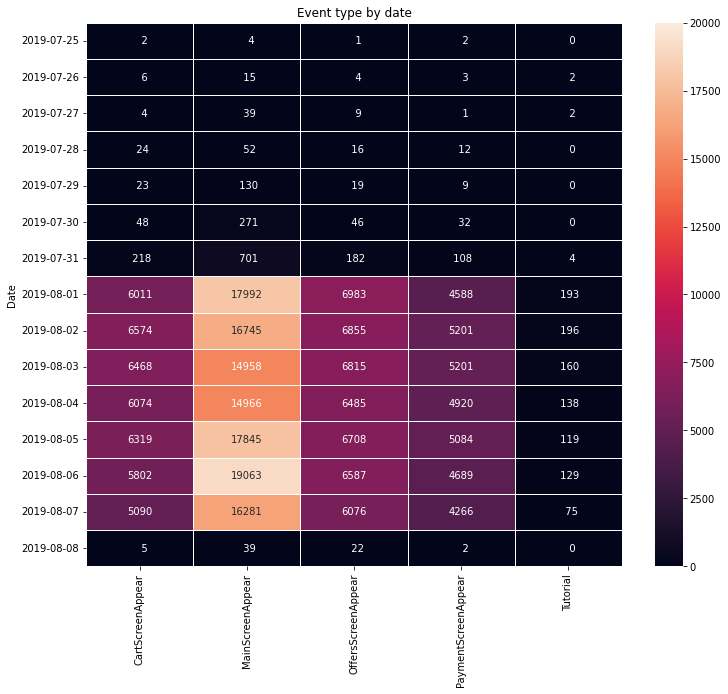

In [38]:
fig, ax = plt.subplots()
heat_map = sns.heatmap(event_props, annot=True, fmt='4', linewidths=1, linecolor='white',  vmax=20000, cbar_kws= {'orientation': 'vertical'} 
            ).set(title = 'Event type by date')
#y1 = ax.set_ylim(0,250) #leaving some outliers out so we can clearly see the graph
#x99 = box_plot.set_title("Seat number by chain type")
fig.set_size_inches(12,10)
plt.show()

Here, we see again the dominant period of 7 days between Aug. 1st and Aug. 7th.  
The heat map also demonstrates that the most common event type is obviously associated with the main screen, followed by offers, cart and payment.

### Time outliers users

The last thing to check is whether the users from the early period continue to the test itself.  
Are they all from one specific group? (control/test)  
Do they have unique features?  
These users are a risk factor because we do not know what they saw to begin with and should therefore exclude them.

In [39]:
out_users = df[df['timestamp'].between(datetime.strptime('2019-07-25', '%Y-%m-%d'),
                                datetime.strptime('2019-07-31', '%Y-%m-%d'),
                                inclusive='both')]['user_id'].unique()

In [40]:
len(out_users)

537

In [41]:
out_users[0:5]

array([4575588528974610257, 7416695313311560658, 3518123091307005509,
       6217807653094995999, 8351860793733343758], dtype=int64)

In [42]:
examine(df[df['user_id'].isin(out_users)])


***************
 head:
                 event_name              user_id           timestamp  \
0         MainScreenAppear  4575588528974610257 2019-07-25 07:43:36   
1         MainScreenAppear  7416695313311560658 2019-07-25 14:11:42   
2  PaymentScreenSuccessful  3518123091307005509 2019-07-25 14:28:47   
3         CartScreenAppear  3518123091307005509 2019-07-25 14:28:47   
4  PaymentScreenSuccessful  6217807653094995999 2019-07-25 14:48:42   

  experiment_id       date    date_str  time_str                time  
0           246 2019-07-25  2019-07-25  07:43:36 1900-01-01 07:43:36  
1           246 2019-07-25  2019-07-25  14:11:42 1900-01-01 14:11:42  
2           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
3           248 2019-07-25  2019-07-25  14:28:47 1900-01-01 14:28:47  
4           248 2019-07-25  2019-07-25  14:48:42 1900-01-01 14:48:42   


***************
 tail:
               event_name              user_id           timestamp  \
243998  MainScreenAppear  

In [43]:
examine(df[~df['user_id'].isin(out_users)])


***************
 head:
              event_name              user_id           timestamp  \
777  OffersScreenAppear  4948674310025878773 2019-07-31 00:08:03   
778    MainScreenAppear  6228621760186964064 2019-07-31 00:11:02   
779    MainScreenAppear  7046680021796213910 2019-07-31 00:28:26   
780    MainScreenAppear   735251485903965518 2019-07-31 00:34:53   
781    MainScreenAppear  8545460827685988062 2019-07-31 00:40:05   

    experiment_id       date    date_str  time_str                time  
777           246 2019-07-31  2019-07-31  00:08:03 1900-01-01 00:08:03  
778           248 2019-07-31  2019-07-31  00:11:02 1900-01-01 00:11:02  
779           248 2019-07-31  2019-07-31  00:28:26 1900-01-01 00:28:26  
780           248 2019-07-31  2019-07-31  00:34:53 1900-01-01 00:34:53  
781           247 2019-07-31  2019-07-31  00:40:05 1900-01-01 00:40:05   


***************
 tail:
                 event_name              user_id           timestamp  \
244121    MainScreenAppear  45

There are no unique features for the data originating from the time outliers users.  
(other than a very slightly reduced frequency for group 246 compared with the two other groups)  
We will drop the 537 users and their associated 14722 entries below.

### User id

In [44]:
df.user_id.describe()

count    2.437130e+05
mean     4.627963e+18
std      2.642723e+18
min      6.888747e+15
25%      2.372212e+18
50%      4.623192e+18
75%      6.932517e+18
max      9.222603e+18
Name: user_id, dtype: float64

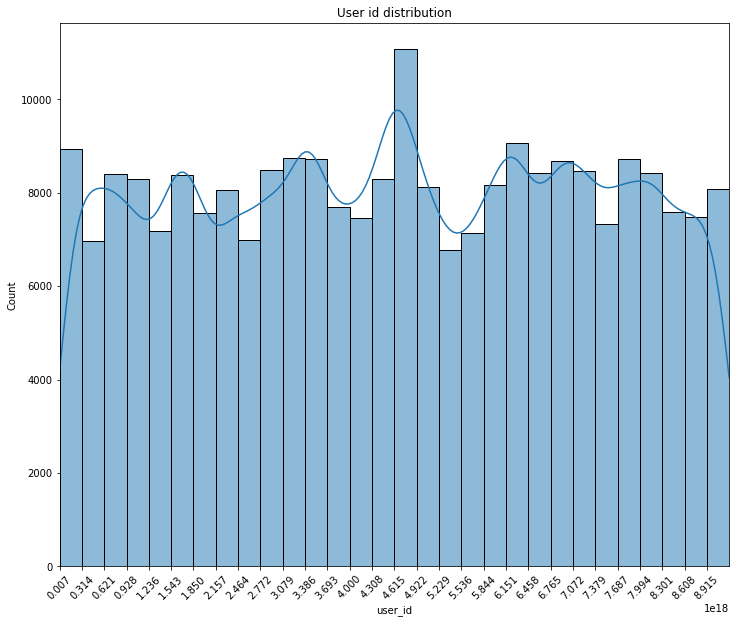

In [45]:
fig, ax = plt.subplots()
hisplot = sns.histplot(data = df, x = "user_id", bins=30, kde=True)
x1 = ax.set_xlim(df.user_id.min(),df.user_id.max())
x2 = ax.set_xticks(range(df.user_id.min(),
                         df.user_id.max(),
                         int((df.user_id.max()-df.user_id.min())/30)))
x98 = plt.xticks(rotation=45)
x99 = hisplot.set_title("User id distribution")
fig.set_size_inches(12,10)
plt.show()

We can see that user_id values are roughly evenly distributed.  
Maybe some accounts are simply very old so their identification numbers are smaller...

## Clean time outliers and their users

In [46]:
df = df[df['timestamp'].between(datetime.strptime('2019-08-01', '%Y-%m-%d'),
                                datetime.strptime('2019-08-07', '%Y-%m-%d'),
                                inclusive='both')]

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 209868 entries, 1990 to 212221
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   event_name     209868 non-null  category      
 1   user_id        209868 non-null  int64         
 2   timestamp      209868 non-null  datetime64[ns]
 3   experiment_id  209868 non-null  category      
 4   date           209868 non-null  datetime64[ns]
 5   date_str       209868 non-null  object        
 6   time_str       209868 non-null  object        
 7   time           209868 non-null  datetime64[ns]
dtypes: category(2), datetime64[ns](3), int64(1), object(2)
memory usage: 11.6+ MB


In [48]:
df = df[~df['user_id'].isin(out_users)]

In [49]:
examine(df)


***************
 head:
               event_name              user_id           timestamp  \
1990    MainScreenAppear  7701922487875823903 2019-08-01 00:00:57   
1991    MainScreenAppear  2539077412200498909 2019-08-01 00:01:45   
1992  OffersScreenAppear  3286987355161301427 2019-08-01 00:02:21   
1993  OffersScreenAppear  3187166762535343300 2019-08-01 00:02:23   
1994    MainScreenAppear  1118952406011435924 2019-08-01 00:03:25   

     experiment_id       date    date_str  time_str                time  
1990           247 2019-08-01  2019-08-01  00:00:57 1900-01-01 00:00:57  
1991           247 2019-08-01  2019-08-01  00:01:45 1900-01-01 00:01:45  
1992           248 2019-08-01  2019-08-01  00:02:21 1900-01-01 00:02:21  
1993           247 2019-08-01  2019-08-01  00:02:23 1900-01-01 00:02:23  
1994           248 2019-08-01  2019-08-01  00:03:25 1900-01-01 00:03:25   


***************
 tail:
                      event_name              user_id           timestamp  \
212217  Payme

## Ensuring no double routing

In [50]:
df.groupby(['user_id'])['experiment_id'].nunique().reset_index().query('experiment_id>1')

,user_id,experiment_id


No user is directed to more than one group

# Step 3. Study and check the data

## How many events are in the logs?

In [51]:
len(df)

197816

We already know that we have 5 types of them (see heat map and histograms above for distributions)...

## How many users are in the logs?

In [52]:
df['user_id'].nunique()

6805

## What's the average number of events per user?

In [53]:
df.groupby(['user_id'])['event_name'].count().agg({'mean', 'median', 'max', 'min'})

mean        29.069214
median      17.000000
max       2293.000000
min          1.000000
Name: event_name, dtype: float64

Validate:

In [54]:
len(df)/df['user_id'].nunique()

29.06921381337252

Let us check the number of unique event types per user

In [55]:
df.groupby(['user_id'])['event_name'].nunique().reset_index().sort_values(by='event_name', ascending=False).head()

,user_id,event_name
3099,4294735467443373934,5
6491,8777962667596552465,5
435,624637828747274142,5
434,623940637775064759,5
5451,7451823951764636968,5


In [56]:
df.groupby(['user_id'])['event_name'].nunique().reset_index().sort_values(by='event_name', ascending=False).tail()

,user_id,event_name
3274,4517722896827490720,1
3281,4527484608661947777,1
3282,4529130891526883120,1
3283,4530866328707864508,1
6804,9222603179720523844,1


In [57]:
df.groupby(['user_id'])['event_name'].nunique().reset_index()['event_name'].value_counts()

4    2744
1    2449
2     879
5     428
3     305
Name: event_name, dtype: int64

As we can see, we have a lot of variability in user activity.  
Some users perform only one action (probably only reach the main screen and do not proceed to cart or purchase - we already saw that from the heat map above - ~3-4 times more for the main screen page.).  
However, some users are very active and have thousands of events and all types (they convert and purchase).  
(They are the outliers that cause the mean 29 to approach twice the median 17...)  
These are probably commercial accounts.

Remark - the trends above and the heat map are hinting towards the funnel to come...

## What period of time does the data cover?

(Find the maximum and the minimum date.)

This was performed above (July 25th to Aug. 8th before cleaning).  
Though the test probably took place from Aug. 1st to Aug. 7th.

### Plot a histogram by date and time.

Performed above.

### Can you be sure that you have equally complete data for the entire period?

* Older events could end up in some users' logs for technical reasons, and this could skew the overall picture.  
* Find the moment at which the data starts to be complete and ignore the earlier section.  
* What period does the data actually represent?

As demonstrated above, the test period was Aug. 1st through Aug. 7th.  
The data was sliced accordingly (events and users wise).

## Did you lose many events and users when excluding the older data?

It was demonstrated above that I lost a little below 14% of the data by date slicing.  
Additional 537 users and their associated 14722 entries (out of 209868 entries this number represents additional 7%) were lost to removial of "suspicious" users.

In [58]:
14722/209868

0.070148855471058

## Make sure you have users from all three experimental groups.

We already saw above (end of section 6.7) that for group 248 we have 70134 entries, for group 246 we have 65134 entries and for group 247 we have 62548 entries.

For users:

In [59]:
df.groupby(['experiment_id'])['user_id'].nunique()

experiment_id
246    2241
247    2276
248    2288
Name: user_id, dtype: int64

We can see that the users are reasonably distributed among the three groups

# Step 4. Study the event funnel

## See what events are in the logs and their frequency of occurrence.

(Sort them by frequency.)

In [60]:
df['event_name'].value_counts()

MainScreenAppear           94313
OffersScreenAppear         38811
CartScreenAppear           35510
PaymentScreenSuccessful    28250
Tutorial                     932
Name: event_name, dtype: int64

In [61]:
df['event_name'].value_counts().sum()

197816

In [62]:
df['event_name'].value_counts()/df['event_name'].value_counts().sum()

MainScreenAppear           0.476771
OffersScreenAppear         0.196197
CartScreenAppear           0.179510
PaymentScreenSuccessful    0.142809
Tutorial                   0.004711
Name: event_name, dtype: float64

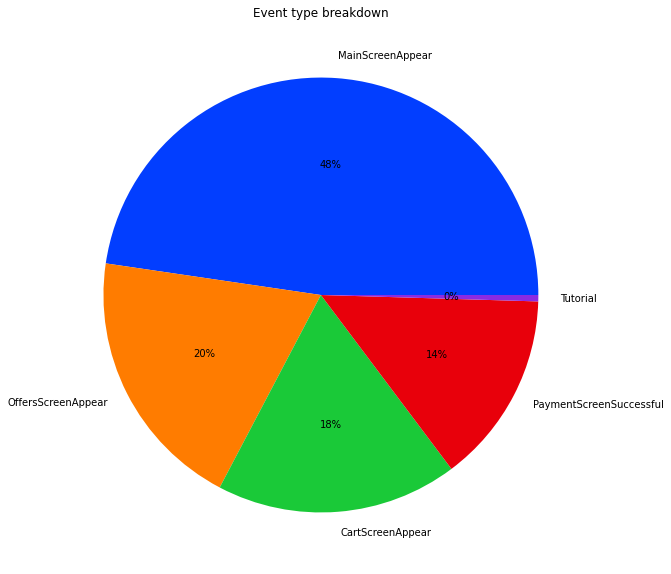

In [63]:
fig, ax = plt.subplots()
#define Seaborn color palette to use
colors = sns.color_palette('bright')
#create pie chart
plt1 = plt.pie(df['event_name'].value_counts(),
               labels = df['event_name'].value_counts().index,
               colors = colors,
               autopct='%.0f%%')
fig.set_size_inches(12,10)
x1 = ax.set_title('Event type breakdown')
plt.show()

We can see that:
* MainScreenAppear' comprises nearly half the event database.
* Nearly no one uses the tutorial.
* The remaining events are roughly equally distributed (14-20%).

## Find the number of users who performed each of these actions. 

### Sort the events by the number of users.

In [64]:
df.groupby(['event_name'])['user_id'].nunique().sort_values(ascending=False)

event_name
MainScreenAppear           6690
OffersScreenAppear         4154
CartScreenAppear           3397
PaymentScreenSuccessful    3225
Tutorial                    772
Name: user_id, dtype: int64

In [65]:
#Original - omitted
#df.groupby(['event_name'])['user_id'].nunique().sort_values(ascending=False) / df.groupby(['event_name'])['user_id'].nunique().sort_values(ascending=False).sum()

#Corrected
df.groupby(['event_name'])['user_id'].nunique().sort_values(ascending=False) / df.user_id.nunique()

event_name
MainScreenAppear           0.983101
OffersScreenAppear         0.610434
CartScreenAppear           0.499192
PaymentScreenSuccessful    0.473916
Tutorial                   0.113446
Name: user_id, dtype: float64

We can see the funnel.   
**Funnel description:**  
* Nearly all users (98%) land on the main page ('MainScreenAppear' event). 
* A little more than half the users (61%) continue to observe the offers ('OffersScreenAppear' event). Here, we lose most (37%) of our users.
* The majority of these users add items to their cart (down to 50%, we lose 11% of users) - 'CartScreenAppear' event.
* Neraly all users that add items to their cart end up as converted (they pay for the items).We lose ony 3% of the users at this stage (down to 47%) - 'PaymentScreenSuccessful' event.
The main challenge is to understand why 37% of our users do not surf to the offers screen.  
Maybe we are offering them the wrong items?  
Or the offers are not being made in the right way?...

### Calculate the proportion of users who performed the action at least once.

In [66]:
action_prop = (df.groupby(['event_name'])['user_id'].nunique().sort_values(ascending=False)/df.user_id.nunique()).reset_index()
action_prop.columns = ['event_name', 'freq']
action_prop

,event_name,freq
0,MainScreenAppear,0.983101
1,OffersScreenAppear,0.610434
2,CartScreenAppear,0.499192
3,PaymentScreenSuccessful,0.473916
4,Tutorial,0.113446


From personal experience, it can happen that I go directly to the cart screen and buy an item that is on sale (Amazon, Aliexpress...).  
In these cases, the origin is typically a bid or a banner or a direct mail I get ("this item is on sale, to purchase click here"...)  
That is probably why not all users land on the main page.

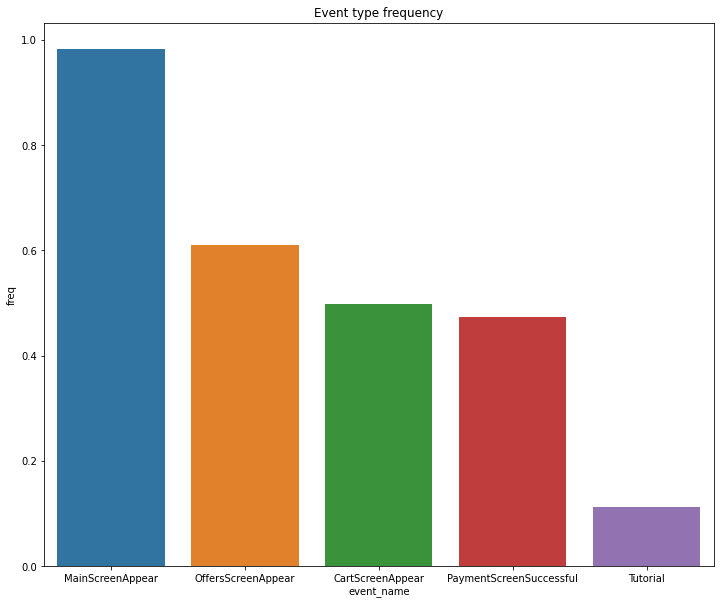

In [67]:
fig, ax = plt.subplots()
bar_plot = sns.barplot(x = action_prop['event_name'],
                       y = action_prop['freq'],
                       data= action_prop,
                       order = action_prop.sort_values(by=['freq'], ascending=False).set_index('event_name').index) 
fig.set_size_inches(12,10)
x1 = ax.set_title('Event type frequency')
plt.show()

#https://stackoverflow.com/questions/43770507/seaborn-bar-plot-ordering

**In what order do you think the actions took place.**

As explained above, I think users are intended to land on the main screen, follow to offers, add things to their cart and then pay and convert.  
But this is hardly the only sequence with which events took place.

**Are all of them part of a single sequence?**

In [68]:
df[df['event_name']!='Tutorial'].groupby('user_id').apply(lambda x: x.sort_values(by = ['timestamp'])).head(30)

event_name           user_id  \
user_id                                                              
6888746892508752 197263         MainScreenAppear  6888746892508752   
6909561520679493 209196         MainScreenAppear  6909561520679493   
                 209199  PaymentScreenSuccessful  6909561520679493   
                 209200         CartScreenAppear  6909561520679493   
                 209201         MainScreenAppear  6909561520679493   
                 209210       OffersScreenAppear  6909561520679493   
6922444491712477 127670         MainScreenAppear  6922444491712477   
                 127672  PaymentScreenSuccessful  6922444491712477   
                 127673         CartScreenAppear  6922444491712477   
                 127674         MainScreenAppear  6922444491712477   
                 127675       OffersScreenAppear  6922444491712477   
                 134267         MainScreenAppear  6922444491712477   
                 134273  PaymentScreenSuccessful  6922444491712477   
                 134274         MainScreenAppear  6922444491712477   
                 134275         CartScreenAppear  6922444491712477   
                 134281       OffersScreenAppear  6922444491712477   
                 158372         MainScreenAppear  6922444491712477   
                 158415       OffersScreenAppear  6922444491712477   
                 158446       OffersScreenAppear  6922444491712477   
                 158579         MainScreenAppear  6922444491712477   
                 158649         MainScreenAppear  6922444491712477   
                 158665         MainScreenAppear  6922444491712477   
                 168758         MainScreenAppear  6922444491712477   
                 168765         MainScreenAppear  6922444491712477   
                 168785       OffersScreenAppear  6922444491712477   
                 168805         MainScreenAppear  6922444491712477   
                 169430         MainScreenAppear  6922444491712477   
                 169455         MainScreenAppear  6922444491712477   
                 169456         CartScreenAppear  6922444491712477   
                 169454  PaymentScreenSuccessful  6922444491712477   

                                  timestamp experiment_id       date  \
user_id                                                                
6888746892508752 197263 2019-08-06 17:06:34           246 2019-08-06   
6909561520679493 209196 2019-08-06 21:52:54           247 2019-08-06   
                 209199 2019-08-06 21:52:58           247 2019-08-06   
                 209200 2019-08-06 21:52:58           247 2019-08-06   
                 209201 2019-08-06 21:52:58           247 2019-08-06   
                 209210 2019-08-06 21:53:04           247 2019-08-06   
6922444491712477 127670 2019-08-04 17:19:33           246 2019-08-04   
                 127672 2019-08-04 17:19:40           246 2019-08-04   
                 127673 2019-08-04 17:19:40           246 2019-08-04   
                 127674 2019-08-04 17:19:40           246 2019-08-04   
                 127675 2019-08-04 17:19:46           246 2019-08-04   
                 134267 2019-08-04 20:16:28           246 2019-08-04   
                 134273 2019-08-04 20:16:32           246 2019-08-04   
                 134274 2019-08-04 20:16:33           246 2019-08-04   
                 134275 2019-08-04 20:16:33           246 2019-08-04   
                 134281 2019-08-04 20:16:44           246 2019-08-04   
                 158372 2019-08-05 16:07:14           246 2019-08-05   
                 158415 2019-08-05 16:07:49           246 2019-08-05   
                 158446 2019-08-05 16:08:37           246 2019-08-05   
                 158579 2019-08-05 16:10:58           246 2019-08-05   
                 158649 2019-08-05 16:12:36           246 2019-08-05   
                 158665 2019-08-05 16:12:49           246 2019-08-05   
                 168758 2019-08-05 19:54:17           246 2019-08-05 

We can see there is no mandatory order of actions.  
Some users can go to the main or tutorial page, read it and leave.  
Other users perform multiple actions jumping back and forth between purchases and the main page.  
Other users may go to the cart page and purchase old items that they added a few days ago.  
Others may reach purchase page directly from a marketing campaign, and so on and so forth...  
Furthermore, on many occasions several activities aggregate to a single timestamp (maybe server overload?) so perhaps the server does not update the database for every single event but rather by quotas (batches)...

In [69]:
user_dates = df[df['event_name']!='Tutorial'].groupby(['user_id'])['date'].nunique().reset_index().sort_values(by = ['date'], ascending = False)
user_dates.head()

,user_id,date
6001,8173190940950873857,6
3262,4497790242237033881,6
3304,4559082052520013938,6
6663,9051953197650074845,6
3300,4553145270890751340,6


As we can see, certain users employed our app for 6 distinct days.  
Neglecting over midnight events (which are rare, see histograms above), we should divide the data by date so we do not carry event sequences.  
In other words, if a day has passed since the user last logged in, the sequence of events should be treated as a new sequence.  
I demonstrate with an example below:

In [70]:
user_i = 8173190940950873857

In [71]:
user_df = df[(df['event_name']!='Tutorial') & (df['user_id'] == user_i)]
user_df

,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
12586,MainScreenAppear,8173190940950873857,2019-08-01 12:39:51,246,2019-08-01,2019-08-01,12:39:51,1900-01-01 12:39:51
12587,PaymentScreenSuccessful,8173190940950873857,2019-08-01 12:39:52,246,2019-08-01,2019-08-01,12:39:52,1900-01-01 12:39:52
12588,CartScreenAppear,8173190940950873857,2019-08-01 12:39:53,246,2019-08-01,2019-08-01,12:39:53,1900-01-01 12:39:53
12589,MainScreenAppear,8173190940950873857,2019-08-01 12:39:53,246,2019-08-01,2019-08-01,12:39:53,1900-01-01 12:39:53
12594,OffersScreenAppear,8173190940950873857,2019-08-01 12:40:02,246,2019-08-01,2019-08-01,12:40:02,1900-01-01 12:40:02
31537,MainScreenAppear,8173190940950873857,2019-08-01 20:27:39,246,2019-08-01,2019-08-01,20:27:39,1900-01-01 20:27:39
31544,PaymentScreenSuccessful,8173190940950873857,2019-08-01 20:27:44,246,2019-08-01,2019-08-01,20:27:44,1900-01-01 20:27:44
31545,CartScreenAppear,8173190940950873857,2019-08-01 20:27:44,246,2019-08-01,2019-08-01,20:27:44,1900-01-01 20:27:44
31547,MainScreenAppear,8173190940950873857,2019-08-01 20:27:45,246,2019-08-01,2019-08-01,20:27:45,1900-01-01 20:27:45
31552,PaymentScreenSuccessful,8173190940950873857,2019-08-01 20:27:49,246,2019-08-01,2019-08-01,20:27:49,1900-01-01 20:27:49


In [72]:
user_df.sort_values(by=['timestamp'])['event_name'].drop_duplicates().to_list()

['MainScreenAppear',
 'PaymentScreenSuccessful',
 'CartScreenAppear',
 'OffersScreenAppear']

In [73]:
user_dt = '2019-08-01'
user_df_dt = user_df[user_df['date'] == user_dt]
user_df_dt
user_df_dt.sort_values(by=['timestamp'])['event_name'].drop_duplicates().to_list()

,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
12586,MainScreenAppear,8173190940950873857,2019-08-01 12:39:51,246,2019-08-01,2019-08-01,12:39:51,1900-01-01 12:39:51
12587,PaymentScreenSuccessful,8173190940950873857,2019-08-01 12:39:52,246,2019-08-01,2019-08-01,12:39:52,1900-01-01 12:39:52
12588,CartScreenAppear,8173190940950873857,2019-08-01 12:39:53,246,2019-08-01,2019-08-01,12:39:53,1900-01-01 12:39:53
12589,MainScreenAppear,8173190940950873857,2019-08-01 12:39:53,246,2019-08-01,2019-08-01,12:39:53,1900-01-01 12:39:53
12594,OffersScreenAppear,8173190940950873857,2019-08-01 12:40:02,246,2019-08-01,2019-08-01,12:40:02,1900-01-01 12:40:02
31537,MainScreenAppear,8173190940950873857,2019-08-01 20:27:39,246,2019-08-01,2019-08-01,20:27:39,1900-01-01 20:27:39
31544,PaymentScreenSuccessful,8173190940950873857,2019-08-01 20:27:44,246,2019-08-01,2019-08-01,20:27:44,1900-01-01 20:27:44
31545,CartScreenAppear,8173190940950873857,2019-08-01 20:27:44,246,2019-08-01,2019-08-01,20:27:44,1900-01-01 20:27:44
31547,MainScreenAppear,8173190940950873857,2019-08-01 20:27:45,246,2019-08-01,2019-08-01,20:27:45,1900-01-01 20:27:45
31552,PaymentScreenSuccessful,8173190940950873857,2019-08-01 20:27:49,246,2019-08-01,2019-08-01,20:27:49,1900-01-01 20:27:49


['MainScreenAppear',
 'PaymentScreenSuccessful',
 'CartScreenAppear',
 'OffersScreenAppear']

In [74]:
user_dt = '2019-08-02'
user_df_dt = user_df[user_df['date'] == user_dt]
user_df_dt
user_df_dt.sort_values(by=['timestamp'])['event_name'].drop_duplicates().to_list()

,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
50359,MainScreenAppear,8173190940950873857,2019-08-02 12:40:34,246,2019-08-02,2019-08-02,12:40:34,1900-01-01 12:40:34
50361,MainScreenAppear,8173190940950873857,2019-08-02 12:40:36,246,2019-08-02,2019-08-02,12:40:36,1900-01-01 12:40:36
50365,CartScreenAppear,8173190940950873857,2019-08-02 12:40:38,246,2019-08-02,2019-08-02,12:40:38,1900-01-01 12:40:38
50366,PaymentScreenSuccessful,8173190940950873857,2019-08-02 12:40:38,246,2019-08-02,2019-08-02,12:40:38,1900-01-01 12:40:38
50368,MainScreenAppear,8173190940950873857,2019-08-02 12:40:38,246,2019-08-02,2019-08-02,12:40:38,1900-01-01 12:40:38
50373,OffersScreenAppear,8173190940950873857,2019-08-02 12:40:43,246,2019-08-02,2019-08-02,12:40:43,1900-01-01 12:40:43
53467,MainScreenAppear,8173190940950873857,2019-08-02 14:12:01,246,2019-08-02,2019-08-02,14:12:01,1900-01-01 14:12:01
53471,MainScreenAppear,8173190940950873857,2019-08-02 14:12:13,246,2019-08-02,2019-08-02,14:12:13,1900-01-01 14:12:13
53472,CartScreenAppear,8173190940950873857,2019-08-02 14:12:13,246,2019-08-02,2019-08-02,14:12:13,1900-01-01 14:12:13
53501,CartScreenAppear,8173190940950873857,2019-08-02 14:13:05,246,2019-08-02,2019-08-02,14:13:05,1900-01-01 14:13:05


['MainScreenAppear',
 'CartScreenAppear',
 'PaymentScreenSuccessful',
 'OffersScreenAppear']

We can observe that by splitting the data for this specific user to two days, we receive a second sequence that was masked when the same data was not split.

Carefull observation reveals that on the second day (Aug. 2nd - see above) the user had multiple sessions from noon to 10PM.  
It could be a commercial account with many company users, each performing his/her own session.  
It could also be the same user logging into the account multiple times a day.  
We do not know.  
In any event, a split is required because after 1/2 an hour even the same user simply forgets what he/she did and must refresh the browser.

Implementation explanation and pseudo-code:

The sequences are extracted by user, date and within each date by above 0.5 gap intervals.

**Pseudo-code:**  
Loop on all unique users  
---Extract each user database  
---Extract each user database unique dates  
---Loop on user dates  
------Extract each user database at each unique date  
------Define session gaps as time periods longer than 0.5 hour between consecutive actions  
---------Loop on each individual session  
------------Extract necessary sequence and append it to database  

In [75]:
sequence=[] 

#for all distinct users -
for user_i in df[df['event_name']!='Tutorial'].user_id.unique(): 
    #select each user data -
    user_df = df[(df['event_name']!='Tutorial') & (df['user_id'] == user_i)]
    #select the user dates -   
    for user_dt in user_df['date'].unique():
        user_df_dt = user_df[user_df['date'] == user_dt].sort_values(by=['timestamp'])
        #define a time gap between consecutive events
        user_df_dt['hr_gap'] = user_df_dt.timestamp.diff().apply(lambda x: x/np.timedelta64(1, 'h')).fillna(0).astype('float64')
        user_df_dt['counter'] = 0
        user_df_dt.loc[user_df_dt['hr_gap'] > 0.5, 'counter'] = 1
        user_df_dt['counter'] = np.cumsum(user_df_dt['counter'],axis=0)
        #split on time gap above 1/2 hour
        for user_counter in user_df_dt['counter'].unique():
            user_df_dt_dcount = user_df_dt[user_df_dt['counter'] == user_counter]
            sequence.append([user_i,
                             user_dt,
                             user_counter,
                             user_df_dt_dcount['timestamp'].min(),
                             tuple(user_df_dt_dcount.sort_values(by=['timestamp'])['event_name'].drop_duplicates().to_list())])

#https://www.codeforests.com/2020/10/04/calculate-date-difference-between-rows/
#http://net-informations.com/python/iq/unhashable.htm

The drop duplicates removes cases where the sequence will not change (screen refresh for example...)

In [76]:
sequence=pd.DataFrame(sequence,columns=['user_id','date','seq_num','timestamp','sequence'])

In [77]:
sequence.head(10)

,user_id,date,seq_num,timestamp,sequence
0,7701922487875823903,2019-08-01,0,2019-08-01 00:00:57,"(MainScreenAppear,)"
1,7701922487875823903,2019-08-01,1,2019-08-01 11:46:47,"(MainScreenAppear,)"
2,7701922487875823903,2019-08-01,2,2019-08-01 17:02:35,"(MainScreenAppear,)"
3,7701922487875823903,2019-08-02,0,2019-08-02 12:27:39,"(MainScreenAppear,)"
4,7701922487875823903,2019-08-02,1,2019-08-02 14:19:30,"(MainScreenAppear,)"
5,7701922487875823903,2019-08-02,2,2019-08-02 16:27:33,"(MainScreenAppear,)"
6,7701922487875823903,2019-08-03,0,2019-08-03 23:13:51,"(MainScreenAppear,)"
7,7701922487875823903,2019-08-04,0,2019-08-04 00:19:16,"(MainScreenAppear,)"
8,7701922487875823903,2019-08-05,0,2019-08-05 00:13:22,"(MainScreenAppear,)"
9,2539077412200498909,2019-08-01,0,2019-08-01 00:01:45,"(MainScreenAppear,)"


In [78]:
sequence[sequence['user_id'] == 8173190940950873857]

,user_id,date,seq_num,timestamp,sequence
13674,8173190940950873857,2019-08-01,0,2019-08-01 12:39:51,"(MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)"
13675,8173190940950873857,2019-08-01,1,2019-08-01 20:27:39,"(MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)"
13676,8173190940950873857,2019-08-02,0,2019-08-02 12:40:34,"(MainScreenAppear, CartScreenAppear, PaymentScreenSuccessful, OffersScreenAppear)"
13677,8173190940950873857,2019-08-02,1,2019-08-02 14:12:01,"(MainScreenAppear, CartScreenAppear, OffersScreenAppear)"
13678,8173190940950873857,2019-08-02,2,2019-08-02 21:29:54,"(MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)"
13679,8173190940950873857,2019-08-02,3,2019-08-02 22:04:01,"(MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)"
13680,8173190940950873857,2019-08-03,0,2019-08-03 14:10:52,"(MainScreenAppear, CartScreenAppear, PaymentScreenSuccessful, OffersScreenAppear)"
13681,8173190940950873857,2019-08-03,1,2019-08-03 23:22:53,"(OffersScreenAppear, MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear)"
13682,8173190940950873857,2019-08-04,0,2019-08-04 09:23:34,"(MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)"
13683,8173190940950873857,2019-08-04,1,2019-08-04 16:04:48,"(MainScreenAppear, OffersScreenAppear)"


In [79]:
sequence['sequence'].value_counts()

(MainScreenAppear,)                                                                  15512
(MainScreenAppear, OffersScreenAppear)                                                7329
(MainScreenAppear, PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)     3033
(MainScreenAppear, CartScreenAppear, PaymentScreenSuccessful, OffersScreenAppear)     2101
(OffersScreenAppear,)                                                                 1682
(MainScreenAppear, OffersScreenAppear, PaymentScreenSuccessful, CartScreenAppear)     1203
(MainScreenAppear, OffersScreenAppear, CartScreenAppear, PaymentScreenSuccessful)     1083
(PaymentScreenSuccessful, CartScreenAppear, OffersScreenAppear)                        512
(OffersScreenAppear, MainScreenAppear)                                                 494
(OffersScreenAppear, PaymentScreenSuccessful, CartScreenAppear)                        446
(MainScreenAppear, CartScreenAppear, OffersScreenAppear)                               424

* Many users leave after landing the main page. Some see the offers page and still leave. These actions represent a large portion of our users. We need to figure out why. Maybe initialize a survey?...  
It's probable that users are already complaining. Otherwise, why is marketing suggesting to change the main screen?...
* As expected, the main screen alone is the most freqeunt sequence.  
Followed by a 'MainScreenAppear, OffersScreenAppear' sequence.  
* After that, we have many variations, the leading one typically starting from the main page.  
* The offers screen appears alone quite frequently. Possibly offers being pushed to users...  
* Some sequences start with PaymentScreenSuccessful. These probably represent commercial accounts. I am familiar with this sequence from my work. Some users (say engineering or technical) add the orders to the cart but have no permission to purchase. Then (later, on a new session...) accounting or the manager logs in, approves the orders and buys the products.  
Another option is people being routed directly to payments with targeted sales / promotion to enhance conversion (buy one click)...
* Many people in Israel split orders to avoid Taxes. They keep their wanted products on their cart so when they log in the next session they skip offers, go directly to the cart and make the purchase.
* I highly recommend the next study to keep the data related to the purchased items and those on the cart (and prices of course... In Israel tax limit is 75$...).

### Use the event funnel to find the share of users that proceed from each stage to the next. 

In [80]:
funnel_prop = df.groupby(['event_name'])['user_id'].nunique().sort_values(ascending=False).reset_index()
funnel_prop.drop(funnel_prop.index[4], inplace = True )
funnel_prop
#dropping tutorial...

,event_name,user_id
0,MainScreenAppear,6690
1,OffersScreenAppear,4154
2,CartScreenAppear,3397
3,PaymentScreenSuccessful,3225


In [81]:
funnel_prop['perc_chng'] = funnel_prop['user_id'].pct_change()
funnel_prop

,event_name,user_id,perc_chng
0,MainScreenAppear,6690,NaN
1,OffersScreenAppear,4154,-0.379073
2,CartScreenAppear,3397,-0.182234
3,PaymentScreenSuccessful,3225,-0.050633


Not surprisingly (we saw that above), we lose a lot of customers (38%) at the main screen stage (they do not proceed to offers), another 18% at the offers page (they do not proceed to cart) and then 5 percent at the cart stage (they do not pay and convert).

**At what stage do you lose the most users?**  
At the offers screen of course.

**What share of users make the entire journey from their first event to payment?**

In [82]:
(3225-6690)/6690

-0.5179372197309418

We lose ~52% of our users.  
This is a lot.  
We do need to make a change.  
(personally, I feel the font will not be enough...)

### Funnel by group

In [83]:
df.head()

,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
1990,MainScreenAppear,7701922487875823903,2019-08-01 00:00:57,247,2019-08-01,2019-08-01,00:00:57,1900-01-01 00:00:57
1991,MainScreenAppear,2539077412200498909,2019-08-01 00:01:45,247,2019-08-01,2019-08-01,00:01:45,1900-01-01 00:01:45
1992,OffersScreenAppear,3286987355161301427,2019-08-01 00:02:21,248,2019-08-01,2019-08-01,00:02:21,1900-01-01 00:02:21
1993,OffersScreenAppear,3187166762535343300,2019-08-01 00:02:23,247,2019-08-01,2019-08-01,00:02:23,1900-01-01 00:02:23
1994,MainScreenAppear,1118952406011435924,2019-08-01 00:03:25,248,2019-08-01,2019-08-01,00:03:25,1900-01-01 00:03:25


In [84]:
funnel = df[df['event_name']!='Tutorial'].groupby(['experiment_id', 'event_name']).nunique()['user_id'].reset_index()
funnel

,experiment_id,event_name,user_id
0,246,CartScreenAppear,1163
1,246,MainScreenAppear,2201
2,246,OffersScreenAppear,1403
3,246,PaymentScreenSuccessful,1107
4,246,Tutorial,0
5,247,CartScreenAppear,1119
6,247,MainScreenAppear,2240
7,247,OffersScreenAppear,1371
8,247,PaymentScreenSuccessful,1047
9,247,Tutorial,0


In [85]:
funnel.drop(funnel.index[[4, 9, 14]], inplace = True )
funnel
#dropping tutorial...

,experiment_id,event_name,user_id
0,246,CartScreenAppear,1163
1,246,MainScreenAppear,2201
2,246,OffersScreenAppear,1403
3,246,PaymentScreenSuccessful,1107
5,247,CartScreenAppear,1119
6,247,MainScreenAppear,2240
7,247,OffersScreenAppear,1371
8,247,PaymentScreenSuccessful,1047
10,248,CartScreenAppear,1115
11,248,MainScreenAppear,2249


In [86]:
funnel = funnel.sort_values(by=['experiment_id','user_id'],ascending=False)
funnel

,experiment_id,event_name,user_id
11,248,MainScreenAppear,2249
12,248,OffersScreenAppear,1380
10,248,CartScreenAppear,1115
13,248,PaymentScreenSuccessful,1071
6,247,MainScreenAppear,2240
7,247,OffersScreenAppear,1371
5,247,CartScreenAppear,1119
8,247,PaymentScreenSuccessful,1047
1,246,MainScreenAppear,2201
2,246,OffersScreenAppear,1403


With no percent change by plotly express

fig = px.funnel(funnel,
                x = "user_id",
                y = 'event_name',
                color='experiment_id',
                title='Event funnel (stacked)', 
                labels={"user_id": "Users number", "event_name": "Event type"}) #, barmode="overlay" # to display on top of each other

#fig1 = fig.update_traces(xbins_size="D1")


fig3 = fig.update_layout(bargap=0.1,
                        height=600,
                         width=800
                        )   #   , title_text="Side By Side Subplots"

fig.show()

In [87]:
fig = go.Figure()

fig1 = fig.add_trace(go.Funnel(
    name = '248',
    y = funnel.query('experiment_id == "248"').event_name.to_list(),
    x = funnel.query('experiment_id == "248"').user_id.to_list(),
    textposition = "inside",
    textinfo = "value+percent initial"))

fig2 = fig.add_trace(go.Funnel(
    name = '247',
    y = funnel.query('experiment_id == "247"').event_name.to_list(),
    x = funnel.query('experiment_id == "247"').user_id.to_list(),
    textposition = "inside",
    textinfo = "value+percent initial"))

fig3 = fig.add_trace(go.Funnel(
    name = '246',
    y = funnel.query('experiment_id == "246"').event_name.to_list(),
    x = funnel.query('experiment_id == "246"').user_id.to_list(),
    textposition = "inside",
    textinfo = "value+percent initial"))

fig4 = fig.update_layout(height=600,
                         width=800,
                         title_text="Event funnel (stacked)")

fig.show()
#https://plotly.com/python/funnel-charts/

We can see that the test group 248 does not present explicitly improved results compared with both control groups.  
It is indeed better than one group (247) but worse than the other (246, that performs best).  
Maybe fonts are not the way to go?...

### Group dynamics

We should also look at dynamics.  
If users convert twice as fast, even with the same percentage, our test could represent a significant improvement.  
Let's investigate:

In [88]:
conv_time=pd.pivot_table(
    df[df['event_name']!='Tutorial'],
    index=['user_id', 'experiment_id'],
    columns=['event_name'],
    values=['timestamp'],
    aggfunc=min)['timestamp'].reset_index()

In [89]:
conv_time.head()

event_name,user_id,experiment_id,CartScreenAppear,MainScreenAppear,OffersScreenAppear,PaymentScreenSuccessful
0,6888746892508752,246,NaT,2019-08-06 17:06:34,NaT,NaT
1,6909561520679493,247,2019-08-06 21:52:58,2019-08-06 21:52:54,2019-08-06 21:53:04,2019-08-06 21:52:58
2,6922444491712477,246,2019-08-04 17:19:40,2019-08-04 17:19:33,2019-08-04 17:19:46,2019-08-04 17:19:40
3,7435777799948366,248,NaT,2019-08-05 11:06:34,NaT,NaT
4,7702139951469979,247,2019-08-02 17:28:45,2019-08-01 07:29:54,2019-08-01 07:29:56,2019-08-02 17:28:45


In [90]:
conv_time ['conv_time'] = (conv_time['PaymentScreenSuccessful']-conv_time['MainScreenAppear'])//np.timedelta64(1, 'm')

In [91]:
conv_time.head(20)

event_name,user_id,experiment_id,CartScreenAppear,MainScreenAppear,OffersScreenAppear,PaymentScreenSuccessful,conv_time
0,6888746892508752,246,NaT,2019-08-06 17:06:34,NaT,NaT,NaN
1,6909561520679493,247,2019-08-06 21:52:58,2019-08-06 21:52:54,2019-08-06 21:53:04,2019-08-06 21:52:58,0.0
2,6922444491712477,246,2019-08-04 17:19:40,2019-08-04 17:19:33,2019-08-04 17:19:46,2019-08-04 17:19:40,0.0
3,7435777799948366,248,NaT,2019-08-05 11:06:34,NaT,NaT,NaN
4,7702139951469979,247,2019-08-02 17:28:45,2019-08-01 07:29:54,2019-08-01 07:29:56,2019-08-02 17:28:45,2038.0
5,8486814028069281,248,2019-08-05 07:49:18,2019-08-05 07:52:40,2019-08-05 07:49:13,NaT,NaN
6,8740973466195562,246,NaT,2019-08-02 12:16:48,2019-08-02 12:43:59,NaT,NaN
7,9841258664663090,248,2019-08-03 13:52:15,2019-08-03 13:47:59,2019-08-03 13:49:42,2019-08-03 20:57:27,429.0
8,12692216027168046,246,NaT,2019-08-02 19:28:49,2019-08-05 07:06:02,NaT,NaN
9,15708180189885246,246,2019-08-01 14:06:19,2019-08-01 19:08:23,2019-08-01 08:38:55,2019-08-01 14:06:19,-303.0


Remark:  
Recall the sequence analysis, users can be directed to the payment and only then return to the main screen.  
We do expect occasional negative values.  
It is the absolute difference that indicates the dynamics...

In [92]:
conv_time.query('experiment_id == "248"')['conv_time'].describe()

count    1037.000000
mean      724.580521
std      1539.066323
min     -7174.000000
25%         0.000000
50%         3.000000
75%       826.000000
max      7902.000000
Name: conv_time, dtype: float64

In [93]:
conv_time.query('experiment_id == "247"')['conv_time'].describe()

count    1017.000000
mean      725.813176
std      1727.548049
min     -7547.000000
25%         0.000000
50%         4.000000
75%      1053.000000
max      8225.000000
Name: conv_time, dtype: float64

In [94]:
conv_time.query('experiment_id == "246"')['conv_time'].describe()

count    1072.000000
mean      683.763993
std      1603.822227
min     -7230.000000
25%         0.000000
50%         3.000000
75%       928.250000
max      8053.000000
Name: conv_time, dtype: float64

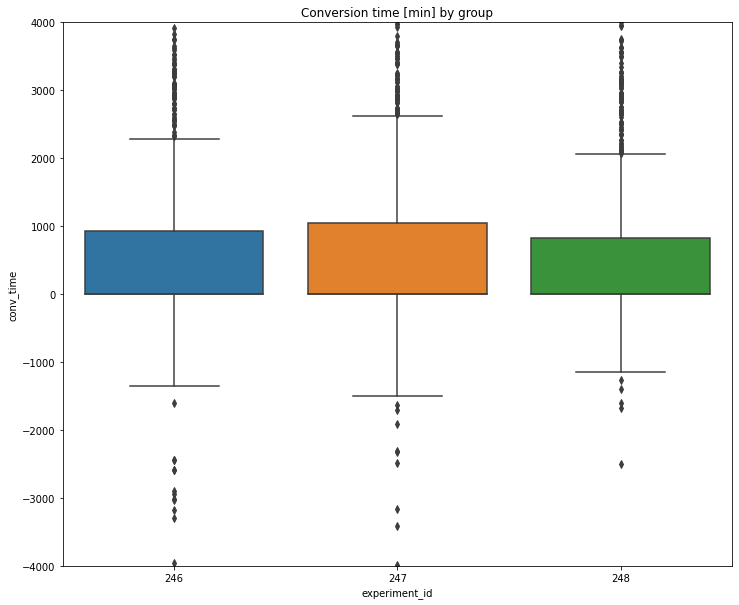

In [95]:
fig, ax = plt.subplots()
box_plot = sns.boxplot(x="experiment_id", y="conv_time", data=conv_time)
y1 = ax.set_ylim(-4000,4000) #leaving some outliers out so we can clearly see the graph
x99 = box_plot.set_title("Conversion time [min] by group")
fig.set_size_inches(12,10)
plt.show()

Indeed, we do see a small hint to enhanced dynamics for group 248.  
The new fonts may do assist in this manner.

# Step 5. Study the results of the experiment

## How many users are there in each group?

In [96]:
df.groupby(['experiment_id'])['user_id'].nunique()

experiment_id
246    2241
247    2276
248    2288
Name: user_id, dtype: int64

Tested above but added here again for comfort.  
There is no big difference between the groups.

## Statistical significance for the control groups

We have two control groups in the A/A test, where we check our mechanisms and calculations.  
See if there is a statistically significant difference between samples 246 and 247.  
Select the most popular event.  
In each of the control groups, find the number of users who performed this action.  
Find their share.  
Check whether the difference between the groups is statistically significant.

Since the groups are not identical in size, and we are asked about shares... we better work with the proportions rather than with the absolute numbers.  

The requirements for the proprotion test are:  
* The sampling method is simple random sampling.
* Each sample point can result in just two possible outcomes.  
We call one of these outcomes a success and the other, a failure.
* The sample includes at least 10 successes and 10 failures.
* The population size is at least 20 times as big as the sample size.

We meet all these conditions so we can run the proprotion test

**Our trials are the number of users:**

In [97]:
users_246 = df.groupby(['experiment_id'])['user_id'].nunique().reset_index().query('experiment_id == "246"')['user_id'].iloc[0]
users_246

2241

In [98]:
users_247 = df.groupby(['experiment_id'])['user_id'].nunique().reset_index().query('experiment_id == "247"')['user_id'].iloc[0]
users_247

2276

In [99]:
users_248 = df.groupby(['experiment_id'])['user_id'].nunique().reset_index().query('experiment_id == "248"')['user_id'].iloc[0]
users_248

2288

**Our successes are actions made:**

In [100]:
action_pivot=df.pivot_table(index='event_name',
                            columns='experiment_id',
                            values='user_id',
                            aggfunc='nunique').reset_index()
action_pivot

experiment_id,event_name,246,247,248
0,CartScreenAppear,1163,1119,1115
1,MainScreenAppear,2201,2240,2249
2,OffersScreenAppear,1403,1371,1380
3,PaymentScreenSuccessful,1107,1047,1071
4,Tutorial,251,266,255


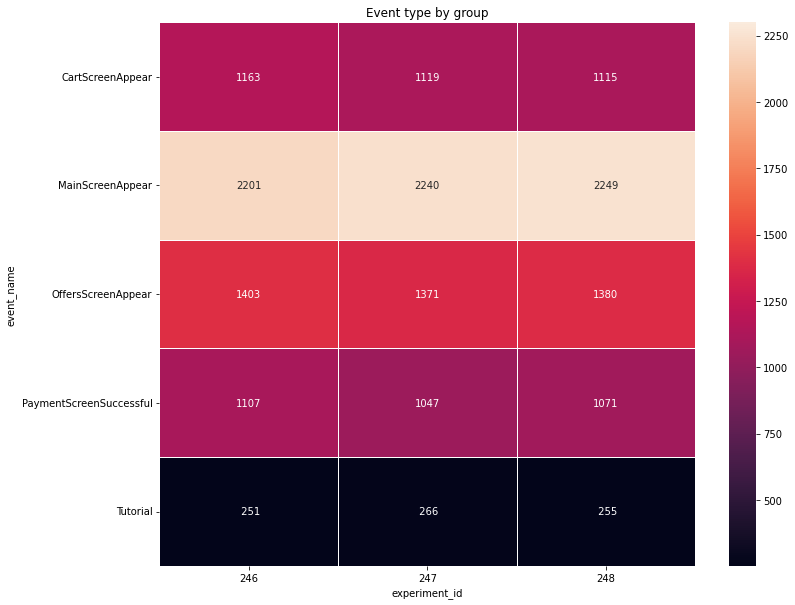

In [101]:
fig, ax = plt.subplots()
heat_map = sns.heatmap(action_pivot.set_index('event_name'), annot=True, fmt='4', linewidths=1, linecolor='white',  vmax=2300, cbar_kws= {'orientation': 'vertical'} 
            ).set(title = 'Event type by group')
#y1 = ax.set_ylim(0,250) #leaving some outliers out so we can clearly see the graph
#x99 = box_plot.set_title("Seat number by chain type")
fig.set_size_inches(12,10)
plt.show()

The nearly identical nature of all groups is clearly evident...

<span class="mark">Define proportions test function:</span>

For a test of two proportions, we are interested in the proportion difference between two groups. If the difference is zero, then the groups are similar (ideally, equal).  
Therefore, the null hypothesis is:  
H0: p1 = p2  
The aletrnative hypothesis is that they are not similar:  
Ha: p1 != p2  
  
https://online.stat.psu.edu/stat800/lesson/5/5.5
https://www.youtube.com/watch?v=76VruarGn2Q

In [102]:
def check_hypothesis(group1,group2,event,alpha=0.05):
    
    print('Event is:', event, '\n')

    success1 = action_pivot[action_pivot.event_name==event][group1].iloc[0]
    print('Group 1 successes is:', success1, '\n')

    success2 = action_pivot[action_pivot.event_name==event][group2].iloc[0]
    print('Group 2 successes is:', success2, '\n')
    
    trials1 = df.groupby(['experiment_id'])['user_id'].nunique().reset_index().query('experiment_id == @group1')['user_id'].iloc[0]
    print('Group 1 trials is:', trials1, '\n')

    trials2 = df.groupby(['experiment_id'])['user_id'].nunique().reset_index().query('experiment_id == @group2')['user_id'].iloc[0]  
    print('Group 2 trials is:', trials2, '\n')
    
    # success proportion in the first group:
    p1 = success1/trials1

    # success proportion in the second group:
    p2 = success2/trials2

    # success proportion in the combined dataset:
    p_combined = (success1 + success2) / (trials1 + trials2)

    # the difference between the datasets' proportions
    difference = p1 - p2
    # calculating the statistic in standard deviations of the standard normal distribution
    z_value = difference / math.sqrt(p_combined * (1 - p_combined) * (1/trials1 + 1/trials2))
    print('Z value is:', z_value, '\n')

    # setting up the standard normal distribution (mean 0, standard deviation 1)
    distr = stats.norm(0, 1)
    # calculating the statistic in standard deviations of the standard normal distribution


    p_value = (1 - distr.cdf(abs(z_value))) * 2
    print('p-value is: ', p_value, '\n')
    
    #Double checking against the built in option:
    stat, pval = proportions_ztest([success1,success2], [trials1,trials2])
    print('built in result: {0:0.3f}'.format(pval))

    if (p_value < alpha):
        print("Rejecting the null hypothesis for", event,"and groups", group1, '&',group2, '\n')
    else:
        print("Failed to reject the null hypothesis for",event,"and groups", group1, '&',group2, '\n')
    

In [103]:
check_hypothesis('246','247','MainScreenAppear',alpha=0.05)

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2240 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: -0.5308822558076411 

p-value is:  0.5955003746397769 

built in result: 0.596
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 247 



We see that in terms of MainScreenAppear proportions, we cannot reject the null hypothesis that the groups are similar.

<span class="mark">**Repeat the procedure for all other events**</span>  
(it will save time if you create a special function for this test).  

In [104]:
for i in action_pivot.event_name.unique():
    check_hypothesis('246','247',i,alpha=0.05)

Event is: CartScreenAppear 

Group 1 successes is: 1163 

Group 2 successes is: 1119 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: 1.835695228752668 

p-value is:  0.0664027440111834 

built in result: 0.066
Failed to reject the null hypothesis for CartScreenAppear and groups 246 & 247 

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2240 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: -0.5308822558076411 

p-value is:  0.5955003746397769 

built in result: 0.596
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 247 

Event is: OffersScreenAppear 

Group 1 successes is: 1403 

Group 2 successes is: 1371 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: 1.6350992292243083 

p-value is:  0.10202824773456731 

built in result: 0.102
Failed to reject the null hypothesis for OffersScreenAppear and groups 246 & 247 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1107 



We can see that the groups appear identical (we cannot refute this) but for the category PaymentScreenSuccessful.  
We have statistically significant different conversion rates for the two control groups.  
This is not a good sign for the validity of our test...  
We already saw this when we constructed the funnel.

<span class="mark">**Can you confirm that the groups were split properly?**</span>

Unfortunately, since the conversion rate appears statistically significantly different, I cannot confirm that the groups were split properly.

## Statistical significance for the test group

Do the same thing for the group with altered fonts.  
Compare the results with those of each of the control groups for each event in isolation.  

In [105]:
for i in action_pivot.event_name.unique():
    check_hypothesis('246','248',i,alpha=0.05)

Event is: CartScreenAppear 

Group 1 successes is: 1163 

Group 2 successes is: 1115 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: 2.129198275671971 

p-value is:  0.033237859514975376 

built in result: 0.033
Rejecting the null hypothesis for CartScreenAppear and groups 246 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2249 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: -0.2065671632194574 

p-value is:  0.8363479070817372 

built in result: 0.836
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 1403 

Group 2 successes is: 1380 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: 1.5839892278140442 

p-value is:  0.11319617049093922 

built in result: 0.113
Failed to reject the null hypothesis for OffersScreenAppear and groups 246 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1107 

Group

We can see that the groups appear identical (we cannot refute this) with respect to all events but for the category CartScreenAppear.

In [106]:
for i in action_pivot.event_name.unique():
    check_hypothesis('247','248',i,alpha=0.05)

Event is: CartScreenAppear 

Group 1 successes is: 1119 

Group 2 successes is: 1115 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: 0.2923740856325242 

p-value is:  0.7700006196996241 

built in result: 0.770
Failed to reject the null hypothesis for CartScreenAppear and groups 247 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 2240 

Group 2 successes is: 2249 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: 0.326333530612506 

p-value is:  0.744172021807622 

built in result: 0.744
Failed to reject the null hypothesis for MainScreenAppear and groups 247 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 1371 

Group 2 successes is: 1380 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: -0.053448436452191016 

p-value is:  0.957374613629381 

built in result: 0.957
Failed to reject the null hypothesis for OffersScreenAppear and groups 247 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1047 

G

Here, we can see that the groups appear identical with respect to all events.

### Compare the results with the combined results for the control groups.

Let us define a new group 2467.  
This group will contain all the data of both the control groups.  
Then we will add this data to the dataframe df.  
In this manner we can re-use the functions we defined above.

In [107]:
df_2467 = pd.concat([
    df.query('experiment_id == "246"'),
    df.query('experiment_id == "247"')],
             ignore_index=True)

In [108]:
df_2467['experiment_id'] = '2467'
df_2467 = df_2467.astype({"experiment_id":'category'})

In [109]:
df_2467.head()
df_2467.tail()
df_2467.info()

,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
0,OffersScreenAppear,3511569580412335882,2019-08-01 00:06:12,2467,2019-08-01,2019-08-01,00:06:12,1900-01-01 00:06:12
1,OffersScreenAppear,3511569580412335882,2019-08-01 00:07:16,2467,2019-08-01,2019-08-01,00:07:16,1900-01-01 00:07:16
2,OffersScreenAppear,5039418296347449582,2019-08-01 00:07:34,2467,2019-08-01,2019-08-01,00:07:34,1900-01-01 00:07:34
3,PaymentScreenSuccessful,5039418296347449582,2019-08-01 00:08:38,2467,2019-08-01,2019-08-01,00:08:38,1900-01-01 00:08:38
4,CartScreenAppear,5039418296347449582,2019-08-01 00:08:38,2467,2019-08-01,2019-08-01,00:08:38,1900-01-01 00:08:38


,event_name,user_id,timestamp,experiment_id,date,date_str,time_str,time
127677,MainScreenAppear,5228694787127532137,2019-08-06 23:59:45,2467,2019-08-06,2019-08-06,23:59:45,1900-01-01 23:59:45
127678,PaymentScreenSuccessful,5228694787127532137,2019-08-06 23:59:46,2467,2019-08-06,2019-08-06,23:59:46,1900-01-01 23:59:46
127679,CartScreenAppear,5228694787127532137,2019-08-06 23:59:47,2467,2019-08-06,2019-08-06,23:59:47,1900-01-01 23:59:47
127680,MainScreenAppear,5228694787127532137,2019-08-06 23:59:48,2467,2019-08-06,2019-08-06,23:59:48,1900-01-01 23:59:48
127681,OffersScreenAppear,5228694787127532137,2019-08-06 23:59:53,2467,2019-08-06,2019-08-06,23:59:53,1900-01-01 23:59:53


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 127682 entries, 0 to 127681
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   event_name     127682 non-null  category      
 1   user_id        127682 non-null  int64         
 2   timestamp      127682 non-null  datetime64[ns]
 3   experiment_id  127682 non-null  category      
 4   date           127682 non-null  datetime64[ns]
 5   date_str       127682 non-null  object        
 6   time_str       127682 non-null  object        
 7   time           127682 non-null  datetime64[ns]
dtypes: category(2), datetime64[ns](3), int64(1), object(2)
memory usage: 6.1+ MB


Preserving original df for convenience.  
This is not a must, we can remove the rows with the new category...

In [110]:
df_temp = df

In [111]:
df = pd.concat([df, df_2467], ignore_index=True)

In [112]:
df.info()
df.experiment_id.value_counts()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 325498 entries, 0 to 325497
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   event_name     325498 non-null  category      
 1   user_id        325498 non-null  int64         
 2   timestamp      325498 non-null  datetime64[ns]
 3   experiment_id  325498 non-null  object        
 4   date           325498 non-null  datetime64[ns]
 5   date_str       325498 non-null  object        
 6   time_str       325498 non-null  object        
 7   time           325498 non-null  datetime64[ns]
dtypes: category(1), datetime64[ns](3), int64(1), object(3)
memory usage: 17.7+ MB


2467    127682
248      70134
246      65134
247      62548
Name: experiment_id, dtype: int64

In [113]:
65108 + 62287

127395

We have the group ready

Update action pivot:

In [114]:
action_pivot=df.pivot_table(index='event_name',
                            columns='experiment_id',
                            values='user_id',
                            aggfunc='nunique').reset_index()
action_pivot

experiment_id,event_name,246,2467,247,248
0,CartScreenAppear,1163,2282,1119,1115
1,MainScreenAppear,2201,4441,2240,2249
2,OffersScreenAppear,1403,2774,1371,1380
3,PaymentScreenSuccessful,1107,2154,1047,1071
4,Tutorial,251,517,266,255


Obviously, the new group is just the addition of the two control groups...

In [115]:
1160+1114

2274

In [116]:
for i in action_pivot.event_name.unique():
    check_hypothesis('2467','248',i,alpha=0.05)

Event is: CartScreenAppear 

Group 1 successes is: 2282 

Group 2 successes is: 1115 

Group 1 trials is: 4517 

Group 2 trials is: 2288 

Z value is: 1.3933933935630451 

p-value is:  0.16350086239411876 

built in result: 0.164
Failed to reject the null hypothesis for CartScreenAppear and groups 2467 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 4441 

Group 2 successes is: 2249 

Group 1 trials is: 4517 

Group 2 trials is: 2288 

Z value is: 0.06655496070536385 

p-value is:  0.9469360023487536 

built in result: 0.947
Failed to reject the null hypothesis for MainScreenAppear and groups 2467 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 2774 

Group 2 successes is: 1380 

Group 1 trials is: 4517 

Group 2 trials is: 2288 

Z value is: 0.877273590960949 

p-value is:  0.3803380529053786 

built in result: 0.380
Failed to reject the null hypothesis for OffersScreenAppear and groups 2467 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 2154

This time we have no statistically significant difference between the control and the tes group for all event categories.

## What conclusions can you draw from the experiment?

* We saw that we have a problem with our control groups.  
They have a statistically significantly different conversion rate.  
This puts our test validity in danger.
* We saw minor changes in the test results when we combined the two groups.  
This is not surprising - the control groups are statistically identical in all event aspects but for conversion.  
The test of proportions is intended to overcome sample size differences (thus proportions...).  
If we combine two samples of similar population characteristics, that are not statistically significantly different from each other, the results of a comparison to a constant third sample should ideally stay the same to those of each original sample compared to the third sample alone.  
(Unless we have extremely border line results to begin with...like here... and in this case our test is not so good from the start).
* Our startup has a big problem with sales and conversion.  
We lose too many customers along the way.  
I guess fonts is not truely the answer...  
I would recommend more drastic changes made in our website.  
Something there is not working well for the users.
* We must correct our results for multiple tests being performed with the same groups.  
#https://towardsdatascience.com/an-overview-of-the-multiple-comparison-problem-166aa5fcaac5

## Study significance level

### What significance level have you set to test the statistical hypotheses mentioned above?  

I used the standard 0.05.

### Calculate how many statistical hypothesis tests you carried out.

For each combination of groups we have 5 event types.  
We are matching the group combinations: 246-247, 246-248, 247-248.  
That means we carried out 5*3 = 15 tests.  
(neglecting for now the combined control group that would result in additional 5 tests)

### With a statistical significance level of 0.1, one in 10 results could be false. What should the significance level be? 

Using a Bonferroni correction, for an original statistical significance level of 0.1 we should use a modified significance level of 0.1/15 = 0.0066..  
This is a very low significance level.  
This is not surprising as it is well established that this correction is very conservative.

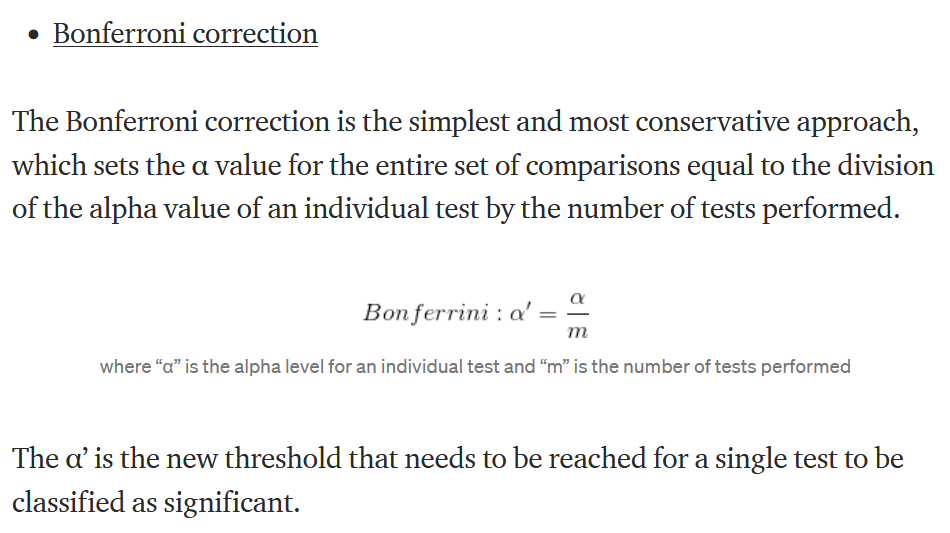
https://towardsdatascience.com/an-overview-of-the-multiple-comparison-problem-166aa5fcaac5

In [117]:
df = df_temp
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 197816 entries, 1990 to 212221
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   event_name     197816 non-null  category      
 1   user_id        197816 non-null  int64         
 2   timestamp      197816 non-null  datetime64[ns]
 3   experiment_id  197816 non-null  category      
 4   date           197816 non-null  datetime64[ns]
 5   date_str       197816 non-null  object        
 6   time_str       197816 non-null  object        
 7   time           197816 non-null  datetime64[ns]
dtypes: category(2), datetime64[ns](3), int64(1), object(2)
memory usage: 10.9+ MB


In [118]:
action_pivot=df.pivot_table(index='event_name',
                            columns='experiment_id',
                            values='user_id',
                            aggfunc='nunique').reset_index()
action_pivot

experiment_id,event_name,246,247,248
0,CartScreenAppear,1163,1119,1115
1,MainScreenAppear,2201,2240,2249
2,OffersScreenAppear,1403,1371,1380
3,PaymentScreenSuccessful,1107,1047,1071
4,Tutorial,251,266,255


In [119]:
for i in action_pivot.event_name.unique():
    check_hypothesis('246','247',i,alpha=0.1/15)

Event is: CartScreenAppear 

Group 1 successes is: 1163 

Group 2 successes is: 1119 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: 1.835695228752668 

p-value is:  0.0664027440111834 

built in result: 0.066
Failed to reject the null hypothesis for CartScreenAppear and groups 246 & 247 

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2240 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: -0.5308822558076411 

p-value is:  0.5955003746397769 

built in result: 0.596
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 247 

Event is: OffersScreenAppear 

Group 1 successes is: 1403 

Group 2 successes is: 1371 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: 1.6350992292243083 

p-value is:  0.10202824773456731 

built in result: 0.102
Failed to reject the null hypothesis for OffersScreenAppear and groups 246 & 247 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1107 



In [120]:
for i in action_pivot.event_name.unique():
    check_hypothesis('246','248',i,alpha=0.1/15)

Event is: CartScreenAppear 

Group 1 successes is: 1163 

Group 2 successes is: 1115 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: 2.129198275671971 

p-value is:  0.033237859514975376 

built in result: 0.033
Failed to reject the null hypothesis for CartScreenAppear and groups 246 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2249 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: -0.2065671632194574 

p-value is:  0.8363479070817372 

built in result: 0.836
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 1403 

Group 2 successes is: 1380 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: 1.5839892278140442 

p-value is:  0.11319617049093922 

built in result: 0.113
Failed to reject the null hypothesis for OffersScreenAppear and groups 246 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1107 

In [121]:
for i in action_pivot.event_name.unique():
    check_hypothesis('247','248',i,alpha=0.1/15)

Event is: CartScreenAppear 

Group 1 successes is: 1119 

Group 2 successes is: 1115 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: 0.2923740856325242 

p-value is:  0.7700006196996241 

built in result: 0.770
Failed to reject the null hypothesis for CartScreenAppear and groups 247 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 2240 

Group 2 successes is: 2249 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: 0.326333530612506 

p-value is:  0.744172021807622 

built in result: 0.744
Failed to reject the null hypothesis for MainScreenAppear and groups 247 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 1371 

Group 2 successes is: 1380 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: -0.053448436452191016 

p-value is:  0.957374613629381 

built in result: 0.957
Failed to reject the null hypothesis for OffersScreenAppear and groups 247 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1047 

G

It is quite expected that with such a low significance level we would have to receive very different groups to obtain statistically significantly differences.

**---------------------------------------**

Using a Šidák correction correction, for an original statistical significance level of 0.1 we should use a modified significance level of:  

In [122]:
#Original
###FWER = 1-(1-alpha)^m
#FWER = 1-pow((1-0.05),15)

#corrected

FWER = 0.05
FWER

0.05

In [123]:
#sidak_alpha=1-(1-FWER)^(1/m)

In [124]:
sidak_alpha=1-pow(1-FWER,1/15)
sidak_alpha

0.0034137129465903193

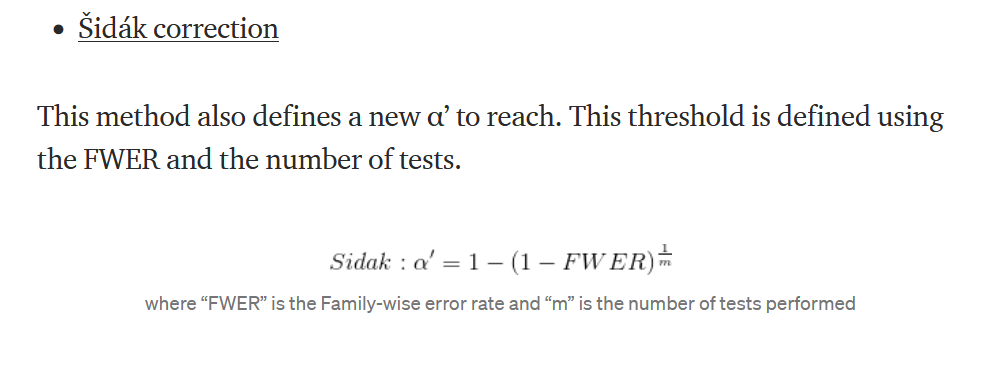
https://towardsdatascience.com/an-overview-of-the-multiple-comparison-problem-166aa5fcaac5
https://personal.utdallas.edu/~herve/Abdi-Bonferroni2007-pretty.pdf

In [126]:
for i in action_pivot.event_name.unique():
    check_hypothesis('246','247',i,alpha=sidak_alpha)

Event is: CartScreenAppear 

Group 1 successes is: 1163 

Group 2 successes is: 1119 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: 1.835695228752668 

p-value is:  0.0664027440111834 

built in result: 0.066
Failed to reject the null hypothesis for CartScreenAppear and groups 246 & 247 

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2240 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: -0.5308822558076411 

p-value is:  0.5955003746397769 

built in result: 0.596
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 247 

Event is: OffersScreenAppear 

Group 1 successes is: 1403 

Group 2 successes is: 1371 

Group 1 trials is: 2241 

Group 2 trials is: 2276 

Z value is: 1.6350992292243083 

p-value is:  0.10202824773456731 

built in result: 0.102
Failed to reject the null hypothesis for OffersScreenAppear and groups 246 & 247 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1107 



In [127]:
for i in action_pivot.event_name.unique():
    check_hypothesis('246','248',i,alpha=sidak_alpha)

Event is: CartScreenAppear 

Group 1 successes is: 1163 

Group 2 successes is: 1115 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: 2.129198275671971 

p-value is:  0.033237859514975376 

built in result: 0.033
Failed to reject the null hypothesis for CartScreenAppear and groups 246 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 2201 

Group 2 successes is: 2249 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: -0.2065671632194574 

p-value is:  0.8363479070817372 

built in result: 0.836
Failed to reject the null hypothesis for MainScreenAppear and groups 246 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 1403 

Group 2 successes is: 1380 

Group 1 trials is: 2241 

Group 2 trials is: 2288 

Z value is: 1.5839892278140442 

p-value is:  0.11319617049093922 

built in result: 0.113
Failed to reject the null hypothesis for OffersScreenAppear and groups 246 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1107 

In [128]:
for i in action_pivot.event_name.unique():
    check_hypothesis('247','248',i,alpha=sidak_alpha)

Event is: CartScreenAppear 

Group 1 successes is: 1119 

Group 2 successes is: 1115 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: 0.2923740856325242 

p-value is:  0.7700006196996241 

built in result: 0.770
Failed to reject the null hypothesis for CartScreenAppear and groups 247 & 248 

Event is: MainScreenAppear 

Group 1 successes is: 2240 

Group 2 successes is: 2249 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: 0.326333530612506 

p-value is:  0.744172021807622 

built in result: 0.744
Failed to reject the null hypothesis for MainScreenAppear and groups 247 & 248 

Event is: OffersScreenAppear 

Group 1 successes is: 1371 

Group 2 successes is: 1380 

Group 1 trials is: 2276 

Group 2 trials is: 2288 

Z value is: -0.053448436452191016 

p-value is:  0.957374613629381 

built in result: 0.957
Failed to reject the null hypothesis for OffersScreenAppear and groups 247 & 248 

Event is: PaymentScreenSuccessful 

Group 1 successes is: 1047 

G

**Obviously, with such a low statistical significance level, we would have all the groups similar...**

Another option is to use the package **multipy** for Multiple hypothesis testing in Python.  
Here, I will not use it because the case is very clear (see below).  
https://puolival.github.io/multipy/

### If you want to change it, run through the previous steps again and check your conclusions.

* This was performed above just for the excercize.
* However, the objective of the Multiple Comparison problem is to correct for Type I error (false positive, i.e. - reject a true null hypothesis or assume that the groups are different when in fact they are similar).  
* When we are correcting the type I error for multiple testing (decreasing the alpha level), we are in fact increasing the probability of Type II error (false negative, i.e. - accept a false null hypothesis or assume that the groups are similar when in fact they are different).  
*This is because you cannot make a type II error at the same time with a type I error (the null hypothesis is either true or false but not both). 
* The standards are set to alpha < 0.05 and beta (Type II error) < 0.20.
* Our company is not a medical company. For a medical company, Type I error means assuming a drug is effective (different results from no drug) when in fact it is not. This is very dangerous because people can get a non-effective drug and get sick or worse. But for a selling company, this  only means ending up with the same sales. We might have wasted some money on the A/B test but not much more than that.
* On the other hand, a Type II error for a medical company means thinking that a drug is not effective when in fact it is. This will lead to not using the drug but not to making the patients conditions worse (no medical negligence lawsuit 😉). In contrast, for our startup, a type II error means not using an effective change or **losing money!**.
* Using a family wise correction reduces the probabilty for Type I error but increases the probabilty for Type II error. Therefore, for a selling company type II error is more important and I would not damage this significance level any further.
* To conclude:
 - It is not recommended to reduce the significance level alpha beyond what we checked above. Our results are quite clear, the differences between the groups are minor (if they exist at all).
 - Some dynamics improvement may justify the use of the bew fonts. So we may salvage something out of all our efforts and money.
 _ However, we should be looking for additional methods to improve our buiness...

https://www.scribbr.com/statistics/type-i-and-type-ii-errors/
https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2996198/
https://www.coursera.org/lecture/stanford-statistics/bonferroni-correction-false-discovery-rate-and-data-splitting-yhbqH